In [1]:
!wget -O screenshot.zip https://box.nju.edu.cn/f/813897fc4edc440a9e12/?dl=1

--2025-03-02 15:24:16--  https://box.nju.edu.cn/f/813897fc4edc440a9e12/?dl=1
Resolving box.nju.edu.cn (box.nju.edu.cn)... 210.28.130.6
Connecting to box.nju.edu.cn (box.nju.edu.cn)|210.28.130.6|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://box.nju.edu.cn/seafhttp/files/753e4823-f7de-449b-a3b3-8f53295b3b81/seeclick_web_imgs_part.zip [following]
--2025-03-02 15:24:17--  https://box.nju.edu.cn/seafhttp/files/753e4823-f7de-449b-a3b3-8f53295b3b81/seeclick_web_imgs_part.zip
Reusing existing connection to box.nju.edu.cn:443.
HTTP request sent, awaiting response... 200 OK
Length: 4823565785 (4.5G) [application/zip]
Saving to: ‘screenshot.zip’

screenshot.zip      100%[===================>]   4.49G  7.79MB/s    in 12m 17s 

2025-03-02 15:36:35 (6.24 MB/s) - ‘screenshot.zip’ saved [4823565785/4823565785]



In [2]:
!unzip screenshot.zip

Выходные данные были обрезаны до нескольких последних строк (5000).
  inflating: cpfs01/user/chengkanzhi/seeclick_web_imgs_part/6ff23d87d30010b89116bf4b058597e3.png  
  inflating: cpfs01/user/chengkanzhi/seeclick_web_imgs_part/9688263d37608f9d99134e439c689d97.png  
  inflating: cpfs01/user/chengkanzhi/seeclick_web_imgs_part/744ade80b5ee8ea98b994e753784ac95.png  
  inflating: cpfs01/user/chengkanzhi/seeclick_web_imgs_part/6245beb72c8f4eb429483eb82fe7c0df.png  
  inflating: cpfs01/user/chengkanzhi/seeclick_web_imgs_part/418e7c7b9fec6a49374cdb3dc1e282b0.png  
  inflating: cpfs01/user/chengkanzhi/seeclick_web_imgs_part/c089495390f6d6dfce076f637a4bfafe.png  
  inflating: cpfs01/user/chengkanzhi/seeclick_web_imgs_part/99fcc22bf130fc58aedefed7a51939b9.png  
  inflating: cpfs01/user/chengkanzhi/seeclick_web_imgs_part/2f1cd9c9a156fb21bbc74da0c003e836.png  
  inflating: cpfs01/user/chengkanzhi/seeclick_web_imgs_part/5955ddd48801ca8694d3476ed301c54c.png  
  inflating: cpfs01/user/chengkanzhi/seec

In [3]:
!wget -O seeclick_web.json https://box.nju.edu.cn/f/3b0f6ccb8bed476c8e39/?dl=1

--2025-03-02 15:38:29--  https://box.nju.edu.cn/f/3b0f6ccb8bed476c8e39/?dl=1
Resolving box.nju.edu.cn (box.nju.edu.cn)... 210.28.130.6
Connecting to box.nju.edu.cn (box.nju.edu.cn)|210.28.130.6|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://box.nju.edu.cn/seafhttp/files/87621dd3-111c-4f7a-95ab-1605f4d13010/seeclick_web.json [following]
--2025-03-02 15:38:30--  https://box.nju.edu.cn/seafhttp/files/87621dd3-111c-4f7a-95ab-1605f4d13010/seeclick_web.json
Reusing existing connection to box.nju.edu.cn:443.
HTTP request sent, awaiting response... 200 OK
Length: 454057738 (433M) [application/octet-stream]
Saving to: ‘seeclick_web.json’

seeclick_web.json   100%[===================>] 433.02M  5.36MB/s    in 50s     

2025-03-02 15:39:20 (8.70 MB/s) - ‘seeclick_web.json’ saved [454057738/454057738]



In [4]:
import os, os.path
import sys
import gc
import cv2
import numpy as np
from PIL import Image

import matplotlib.pyplot as plt
import matplotlib.patches as patches
import matplotlib.image as mpimg

In [5]:
SOURCE_DIR_IMG = "/content/cpfs01/user/chengkanzhi/seeclick_web_imgs_part/"

In [6]:
# Получение всех файлов в директории
def getFilesByPath(dir):
  return [name for name in os.listdir(dir) if os.path.isfile(os.path.join(dir, name))]

In [7]:
len(getFilesByPath(SOURCE_DIR_IMG))

10000

In [8]:
getFilesByPath(SOURCE_DIR_IMG)[0:5]

['d9ce975fdc72218d0a84c242106f9f2c.png',
 'd7034c7cbbd8dfe82ed2ed735624d443.png',
 '64fb61be47842d45519cd8308a5d783e.png',
 'a083908591ba752786fa7bdb28eb6af1.png',
 '042bd47cf8dae03a37d5eb77ecaae7fc.png']

In [9]:
import psutil
process = psutil.Process()
print(process.memory_info().rss / 1024 / 1024)

127.43359375


In [10]:
import json

schemeJSON = {}
with open('/content/seeclick_web.json') as json_file:
  schemeJSON = json.load(json_file)

In [11]:
import psutil
process = psutil.Process()
print(process.memory_info().rss / 1024 / 1024)

1871.484375


In [12]:
len(schemeJSON)

271121

In [13]:
def filteredEntries(source_scheme, dir):
  all_files = getFilesByPath(dir)
  new_scheme = []

  for i in range(0, len(source_scheme)):
    item = source_scheme[i]
    if item["img_filename"] in all_files:
      new_scheme.append(item)

  return new_scheme

In [14]:
subsetScheme = filteredEntries(schemeJSON, SOURCE_DIR_IMG)

schemeJSON.clear()
del schemeJSON
gc.collect()

0

In [57]:
# Сохранение частичной разметки в JSON-файл
with open('subset_norm_seeclick_web.json', 'w') as file:
    json.dump(subsetScheme, file)

In [35]:
len(subsetScheme)

10000

In [37]:
subsetScheme[0]

{'img_filename': 'b1072ebd95d94a714a204ad0a44c2cb0.png',
 'url': 'https://catalogue.slwa.wa.gov.au/record=b1152790~S1',
 'elements': [{'instruction': 'Composers -- Western Australia.',
   'bbox': [0.1125,
    0.8101851851851852,
    0.20260416666666667,
    0.8231481481481482],
   'data_type': 'text'},
  {'instruction': 'InterLibrary Loan',
   'bbox': [0.71875, 0.2851851851851852, 0.7640625, 0.2962962962962963],
   'data_type': 'text'},
  {'instruction': 'Bookmark link for this record',
   'bbox': [0.5604166666666667,
    0.287962962962963,
    0.6161458333333333,
    0.31203703703703706],
   'data_type': 'text'},
  {'instruction': 'Author',
   'bbox': [0.7963541666666667,
    0.2175925925925926,
    0.9828125,
    0.23055555555555557],
   'data_type': 'text'},
  {'instruction': 'Classic Catalogue Home',
   'bbox': [0.0, 0.1037037037037037, 0.1125, 0.1388888888888889],
   'data_type': 'text'},
  {'instruction': 'Search',
   'bbox': [0.540625, 0.225, 0.5682291666666667, 0.24259259259259

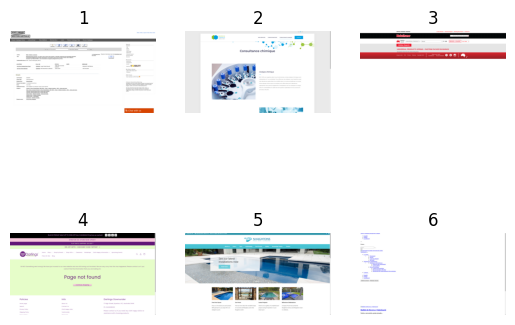

In [ ]:
tenImages = subsetScheme[0:6]

for num, item in enumerate(tenImages):
  img = mpimg.imread(SOURCE_DIR_IMG + item["img_filename"])
  plt.subplot(2, 3, num + 1)
  plt.title(num + 1)
  plt.axis('off')
  plt.imshow(img)

In [ ]:
import jax
import jax.numpy as jnp

def bbox_2_point(bbox):
  point = [(bbox[0] + bbox[2]) / 2, (bbox[1] + bbox[3]) / 2]
  return point

def _yx_in_bounding_boxes(
    yx, bounding_boxes
):
  """Check if the (y,x) point is contained in each bounding box.

  Args:
    yx: The (y, x) coordinate in pixels of the point.
    bounding_boxes: A 2D int array of shape (num_bboxes, 4), where each row
      represents a bounding box: (y_top_left, x_top_left, box_height,
      box_width). Note: containment is inclusive of the bounding box edges.

  Returns:
    is_inside: A 1D bool array where each element specifies if the point is
      contained within the respective box.
  """
  y, x = yx

  # `bounding_boxes` has shape (n_elements, 4); we extract each array along the
  # last axis into shape (n_elements, 1), then squeeze unneeded dimension.
  top, left, height, width = [
      jnp.squeeze(v, axis=-1) for v in jnp.split(bounding_boxes, 4, axis=-1)
  ]

  # The y-axis is inverted for AndroidEnv, so bottom = top + height.
  bottom, right = top + height, left + width

  return jnp.logical_and(y >= top, y <= bottom) & jnp.logical_and(
      x >= left, x <= right)


In [84]:
# Денормализация данных (x, y, width, height)
def convertNormalizeBboxType1(bbox, width, height):
  new_bbox = [bbox[0], bbox[1], bbox[2] - bbox[0], bbox[3] - bbox[1]]
  new_bbox = [new_bbox[0] * width, new_bbox[1] * height, new_bbox[2] * width, new_bbox[3] * height]

  return new_bbox

# Денормализация данных (left, top, right, down)
def convertNormalizeBboxType2(bbox, width, height):
  new_bbox = [bbox[0] * width, bbox[1] * height, bbox[2] * width, bbox[3] * height]

  return new_bbox

In [27]:
# Визуализация изображения с четырёхугольниками
def show_image_with_bboxes(image, bboxes=None):
    img_height = image.shape[0]
    img_width = image.shape[1]

    dpi = 40

    # Размер изображения
    figsize = img_width / float(dpi), img_height / float(dpi)

    # Настройка matplotlib для визуализации
    fig, ax = plt.subplots(1, figsize=figsize)
    ax.imshow(image)

    if isinstance(bboxes, list):
      for i in range(0, len(bboxes)):
        bbox = bboxes[i]
        if (not bbox) or (len(bbox) >= 5 and not isinstance(bbox[4], str)):
          continue

        # Определение координат прямоугольника (x, y, width, height)
        x = int(bbox[0])
        y = int(bbox[1])
        width = int(bbox[2])
        height = int(bbox[3])

        # Определение цвета четырёхугольника
        color = 'black'
        if len(bbox) >= 5:
          color = 'black' if bbox[4] == "text" else 'blue'

        # Добавление в визуализацию matplotlib изображения четырёхугольника
        rect = patches.Rectangle((x, y), width, height, linewidth=5, edgecolor=color, facecolor='none')
        ax.add_patch(rect)

    # Не рисовать оси
    plt.axis('off')

    # Визуализация изображения
    plt.show()


In [85]:
# Визуализация изображения с точками
def show_image_with_points(image, coords=None):
    img_height = image.shape[0]
    img_width = image.shape[1]

    dpi = 40

    # Размер изображения
    figsize = img_width / float(dpi), img_height / float(dpi)

    # Настройка matplotlib для визуализации
    fig, ax = plt.subplots(1, figsize=figsize)
    ax.imshow(image)

    if isinstance(coords, list):
      for i in range(0, len(coords)):
        coord = coords[i]
        if (not coord) or (len(coord) >= 3 and not isinstance(coord[2], str)):
          continue

        # Определение координат элемента (x, y)
        x = int(coord[0])
        y = int(coord[1])

        # Определение цвета четырёхугольника
        color = 'black'
        if len(coord) >= 5:
          color = 'black' if coords[3] == "text" else 'blue'

        # Добавление в визуализацию matplotlib изображения точки
        point = patches.Circle((x, y), radius=5, edgecolor=color, facecolor=color)

        ax.add_patch(point)

    # Не рисовать оси
    plt.axis('off')

    # Визуализация изображения
    plt.show()

In [86]:
# Сборка данных + визуализация данных
def show_image_rect(data):
  # Чтение изображения
  img = cv2.imread(SOURCE_DIR_IMG + data["img_filename"])

  # Получение ширины и высоты изображения
  img_height = img.shape[0]
  img_width = img.shape[1]

  bboxes = []
  elements = data["elements"]

  print("Elements: ", len(elements))

  # Сборка данных о каждом элементе
  for i in range(0, len(elements)):
    temp_bbox = data["elements"][i]["bbox"]

    # Денормализация данных bbox
    temp_bbox = convertNormalizeBboxType1(temp_bbox, img_width, img_height)
    # + добавляем тип элемента, заключённого в bbox
    temp_bbox.append(data["elements"][i]["data_type"])

    bboxes.append(temp_bbox)

  # Визуализация изображения со списком bbox'ов
  show_image_with_bboxes(img, bboxes)

In [91]:
# Преобразование bbox в точку
def bbox_2_point(bbox):
  point = [(bbox[0] + bbox[2]) / 2, (bbox[1] + bbox[3]) / 2]
  return point

# Сборка данных + визуализация данных
def show_image_point(data):
  # Чтение изображения
  img = cv2.imread(SOURCE_DIR_IMG + data["img_filename"])

  # Получение ширины и высоты изображения
  img_height = img.shape[0]
  img_width = img.shape[1]

  points = []
  elements = data["elements"]

  print("Elements: ", len(elements))

  # Сборка данных о каждом элементе
  for i in range(0, len(elements)):
    temp_bbox = data["elements"][i]["bbox"]

    # Денормализация данных bbox
    temp_bbox = convertNormalizeBboxType2(temp_bbox, img_width, img_height)
    # Преобразование bbox в точку
    point = bbox_2_point(temp_bbox)
    # + добавляем тип элемента, заключённого в bbox
    point.append(data["elements"][i]["data_type"])

    points.append(point)

  print(points)
  # Визуализация изображения с точками элементов
  show_image_with_points(img, points)

Elements:  10
[[1284.5, 325.0, 'hover'], [964.5, 25.499999999999996, 'text'], [1302.5, 25.499999999999996, 'text'], [1199.5, 412.5, 'text'], [1280.5, 759.0, 'text'], [778.0, 532.5, 'text'], [520.5, 25.499999999999996, 'text'], [1133.0, 25.499999999999996, 'text'], [677.0, 25.499999999999996, 'text'], [823.5, 25.499999999999996, 'text']]


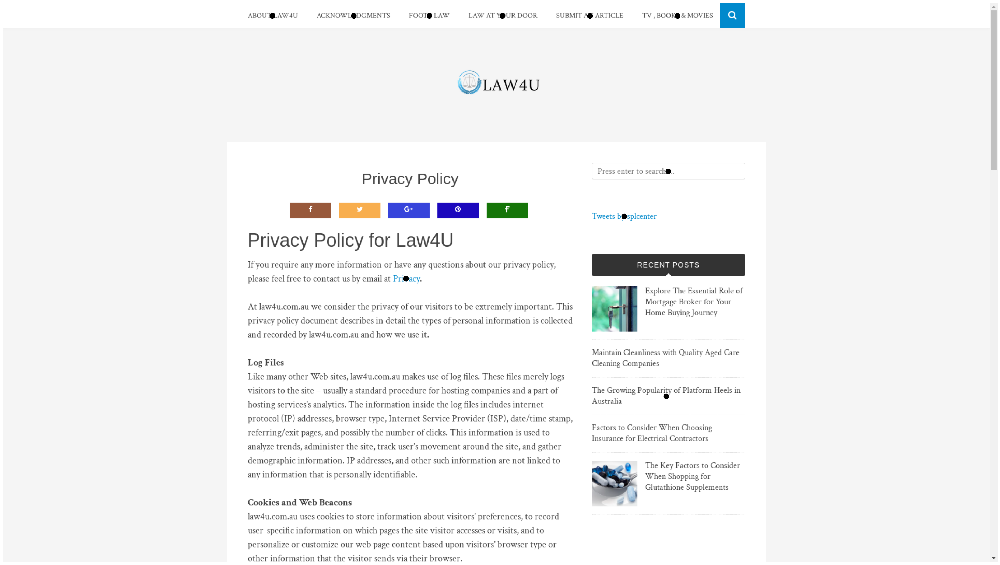

In [95]:
current_item = subsetScheme[0:100][48]
show_image_point(current_item)

Elements:  7


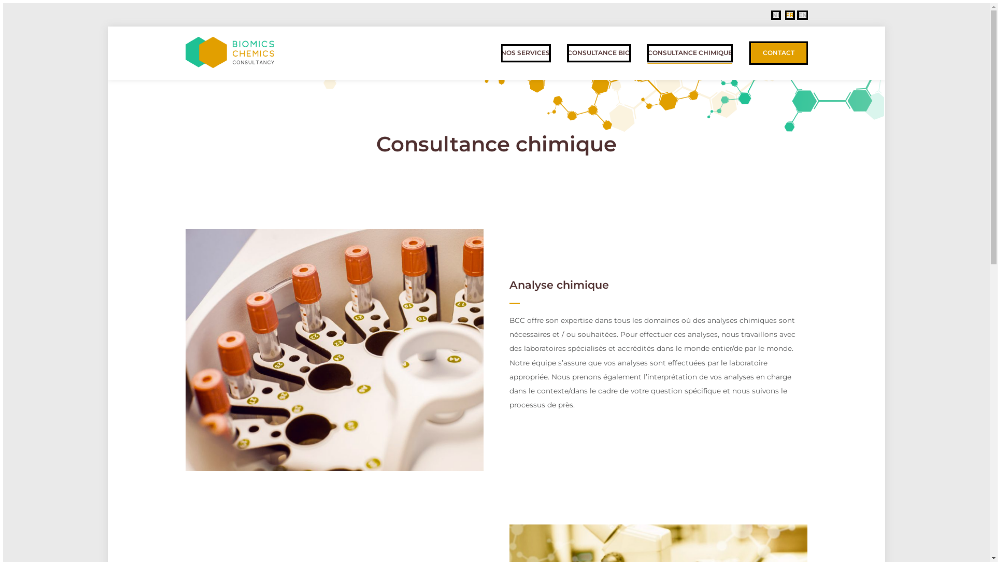

In [55]:
current_item = subsetScheme[0:100][1]
show_image_rect(current_item)

Elements:  43


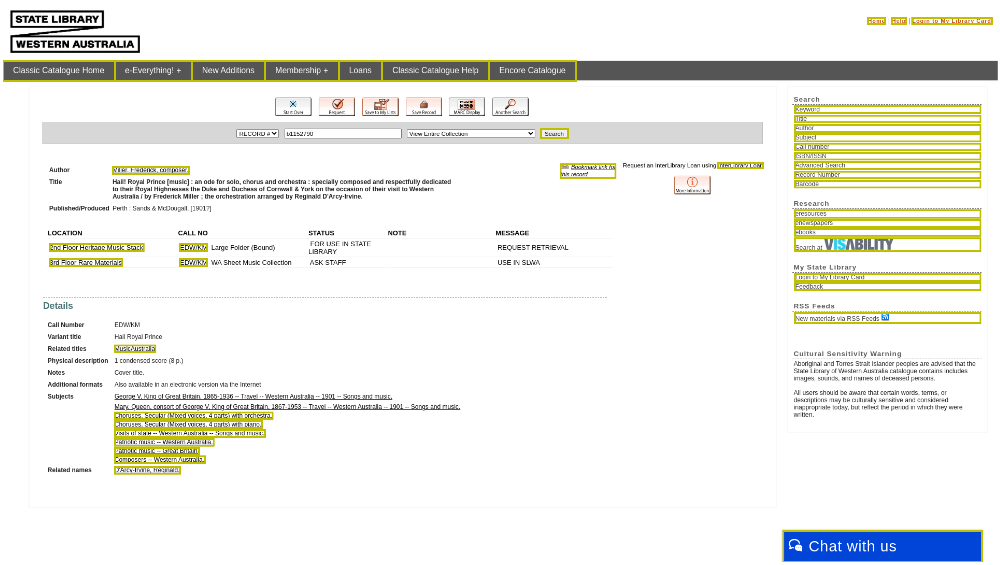

Elements:  7


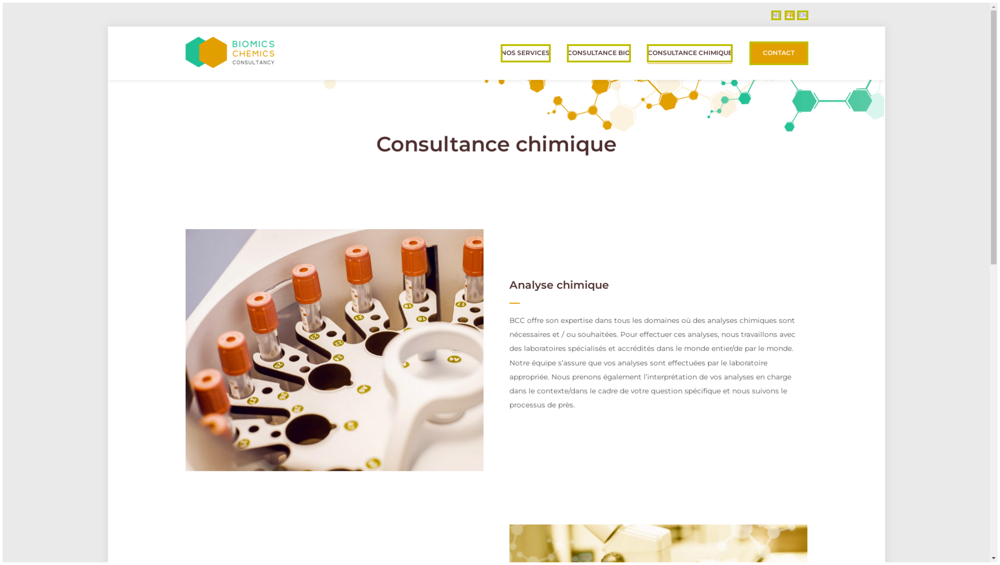

Elements:  11


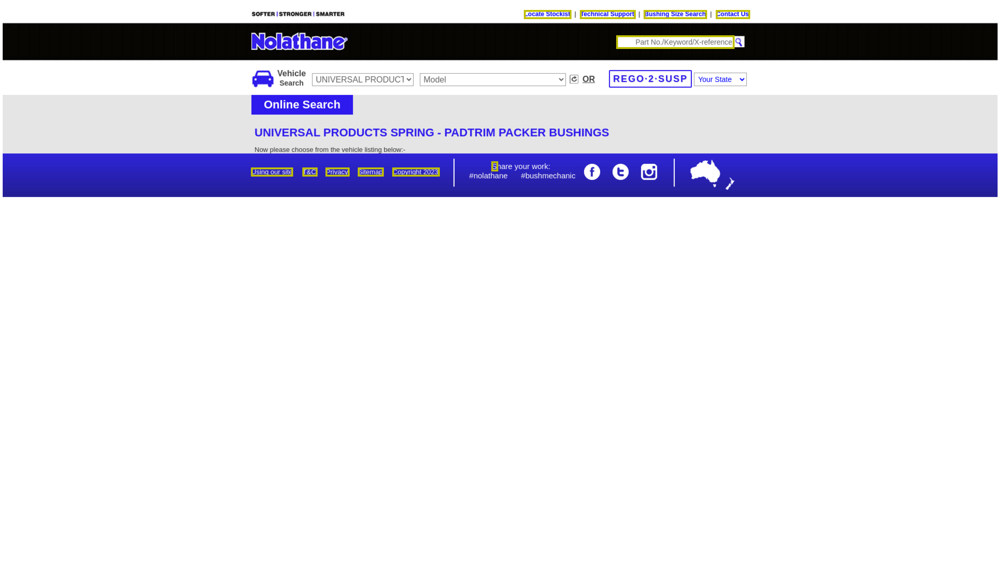

Elements:  20


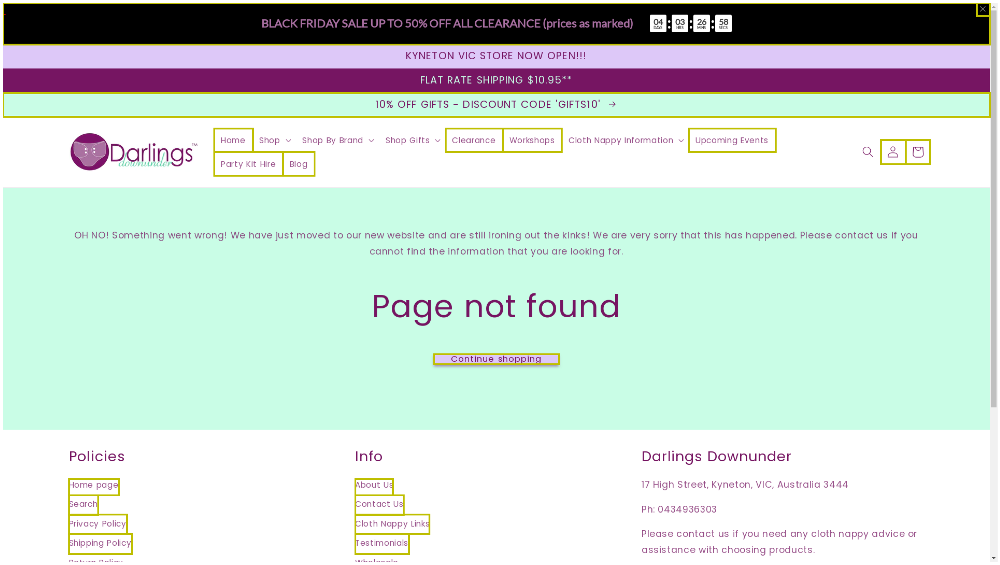

Elements:  11


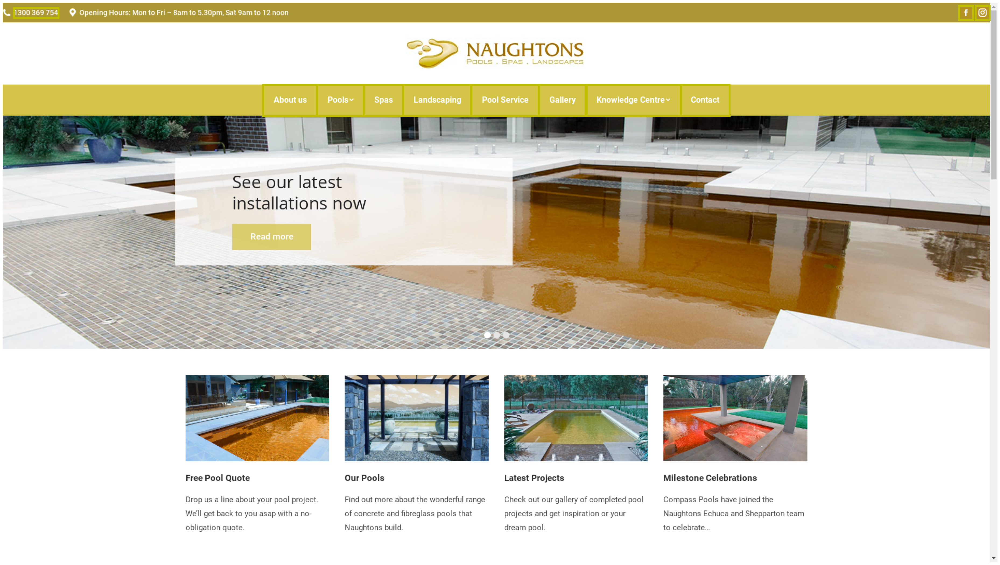

Elements:  16


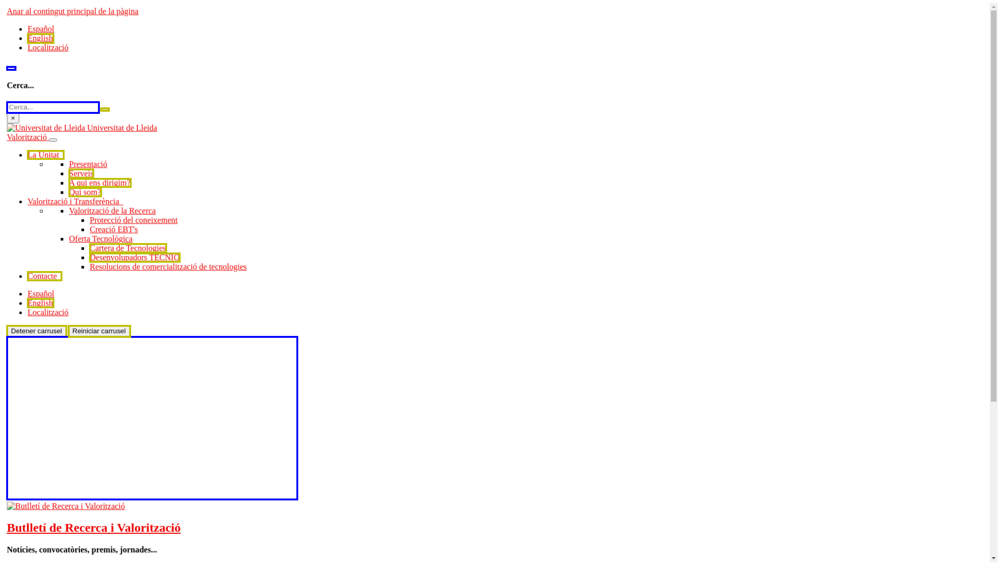

Elements:  23


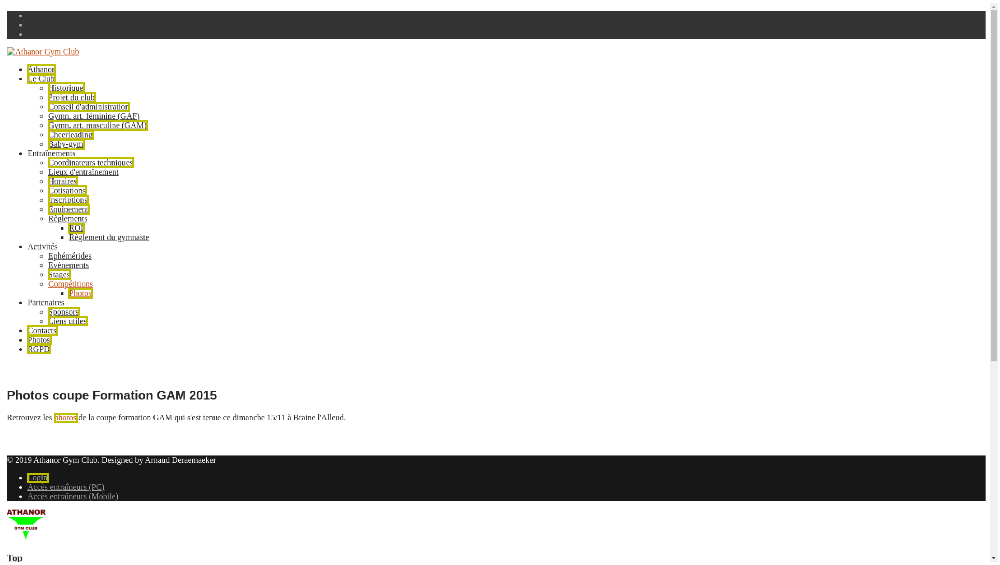

Elements:  11


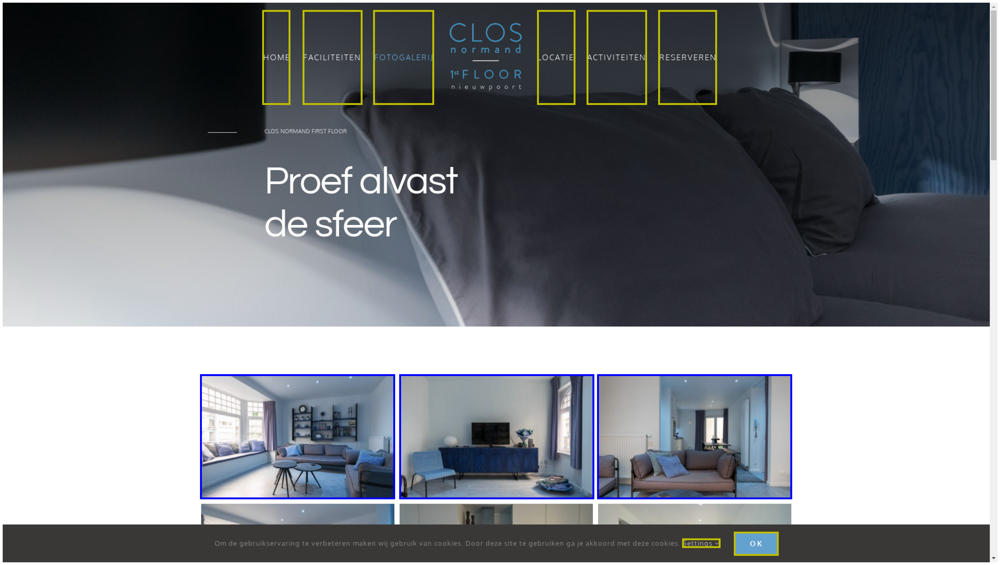

Elements:  86


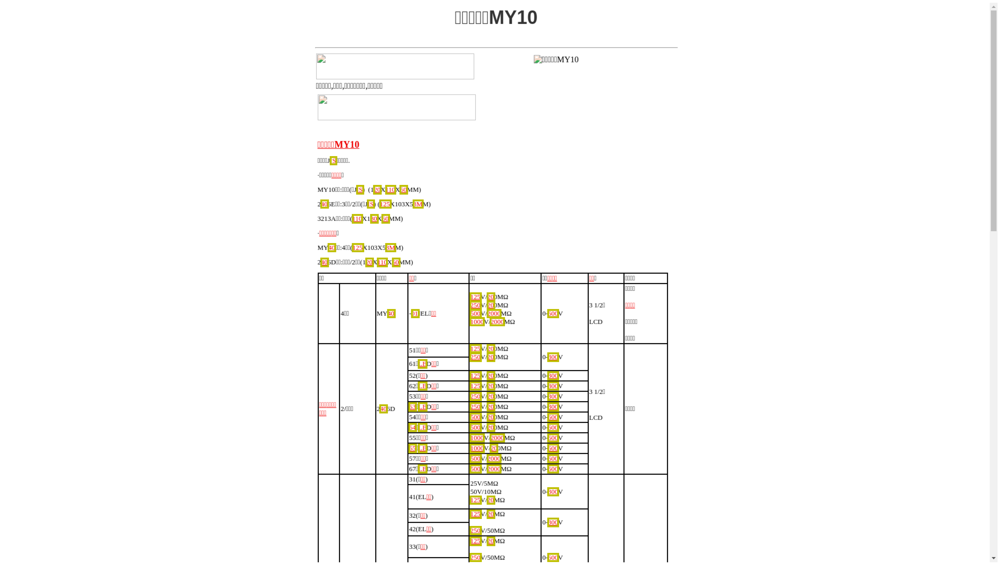

Elements:  7


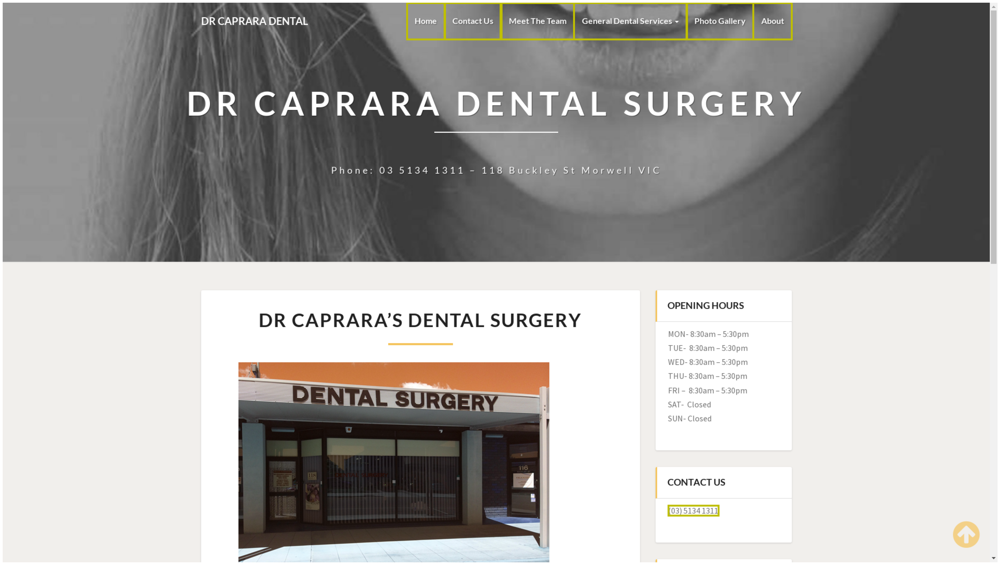

Elements:  1


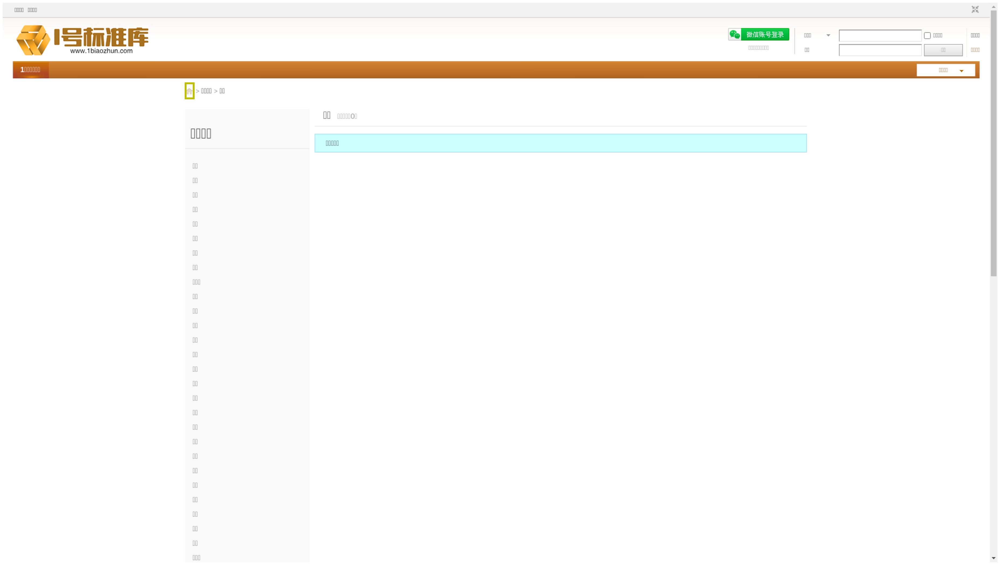

Elements:  12


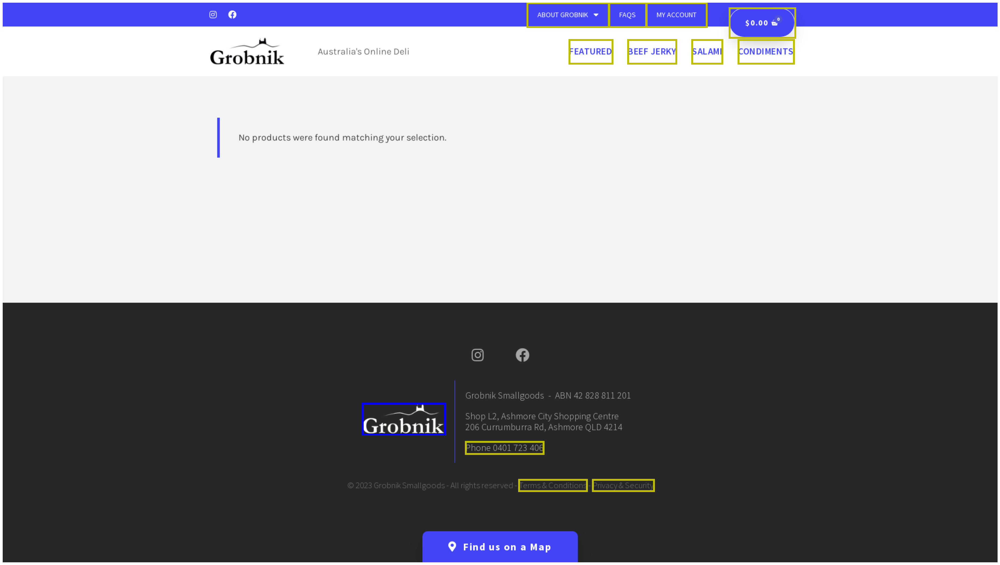

Elements:  1


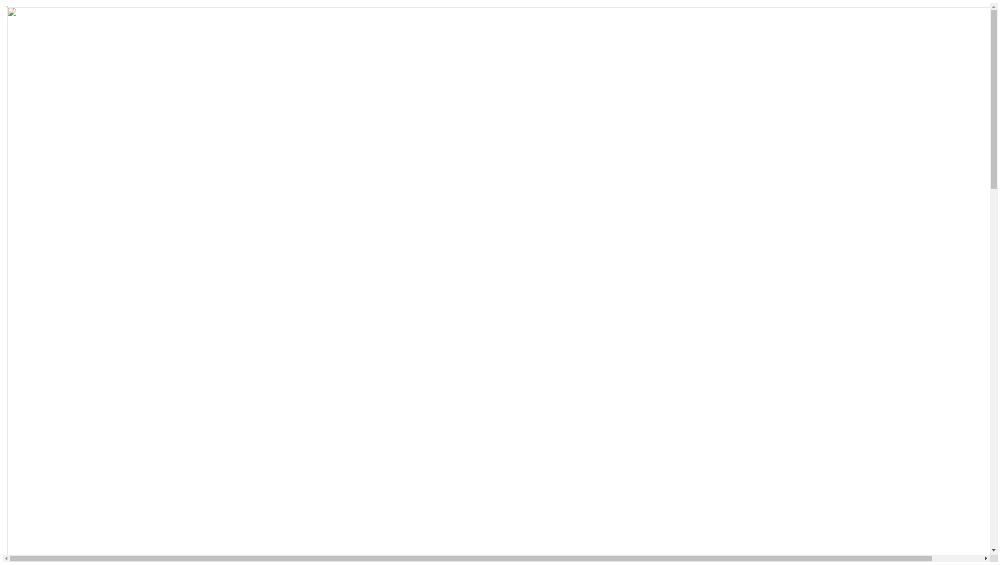

Elements:  12


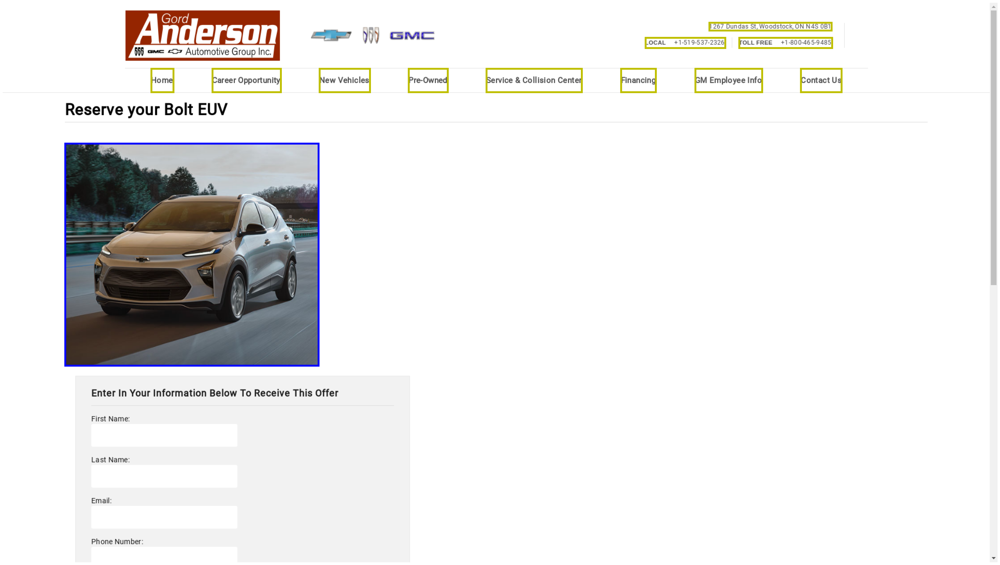

Elements:  13


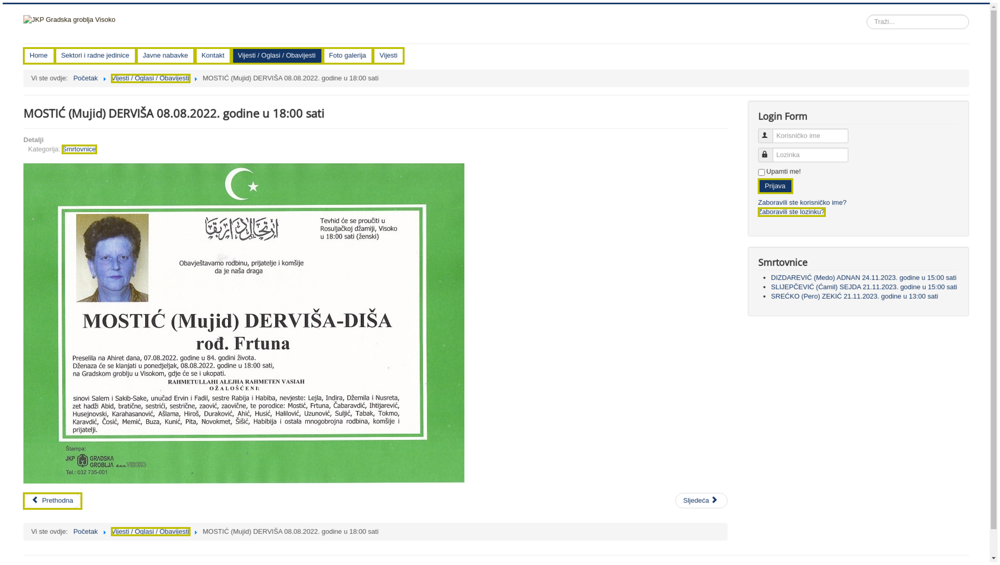

Elements:  1


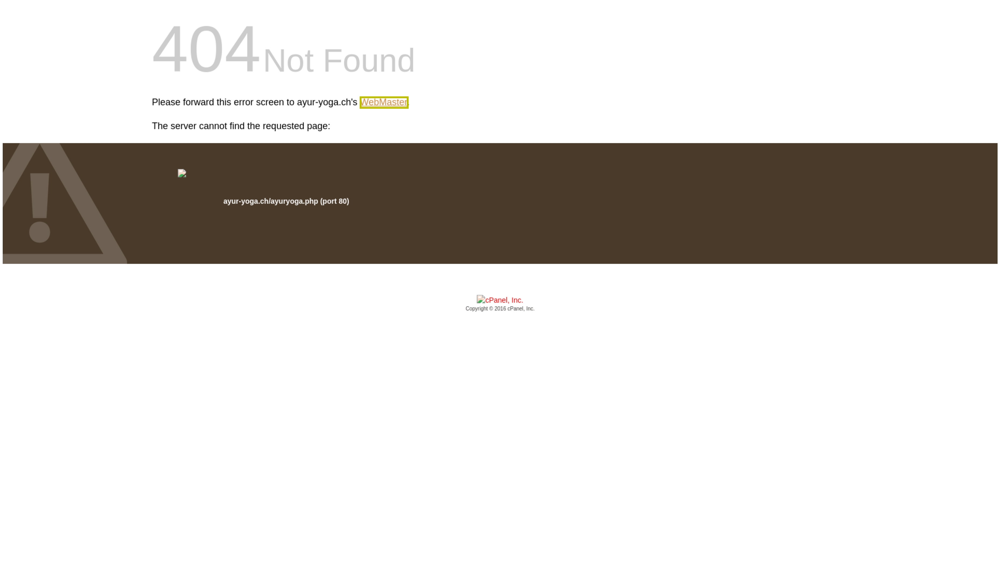

Elements:  24


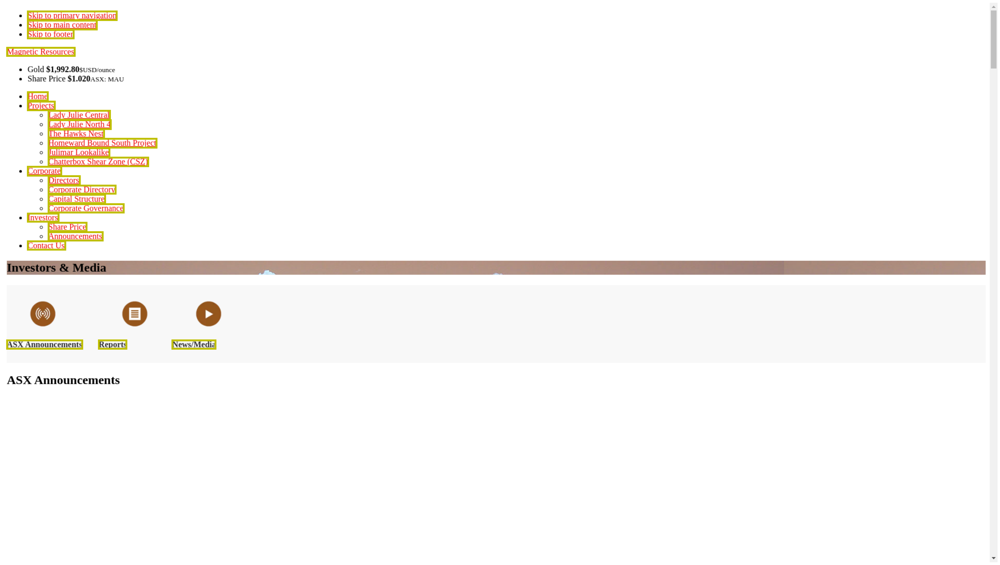

Elements:  57


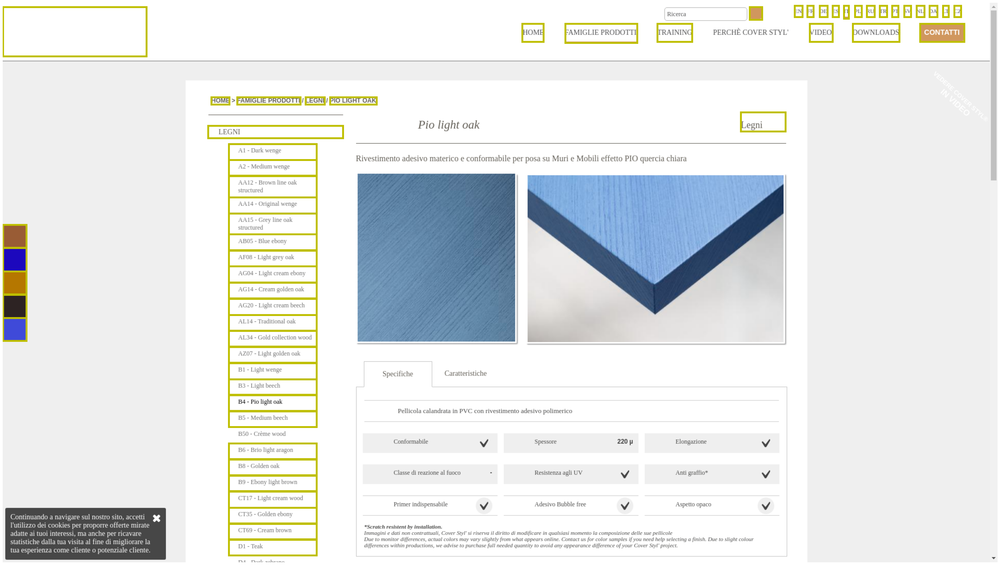

Elements:  15


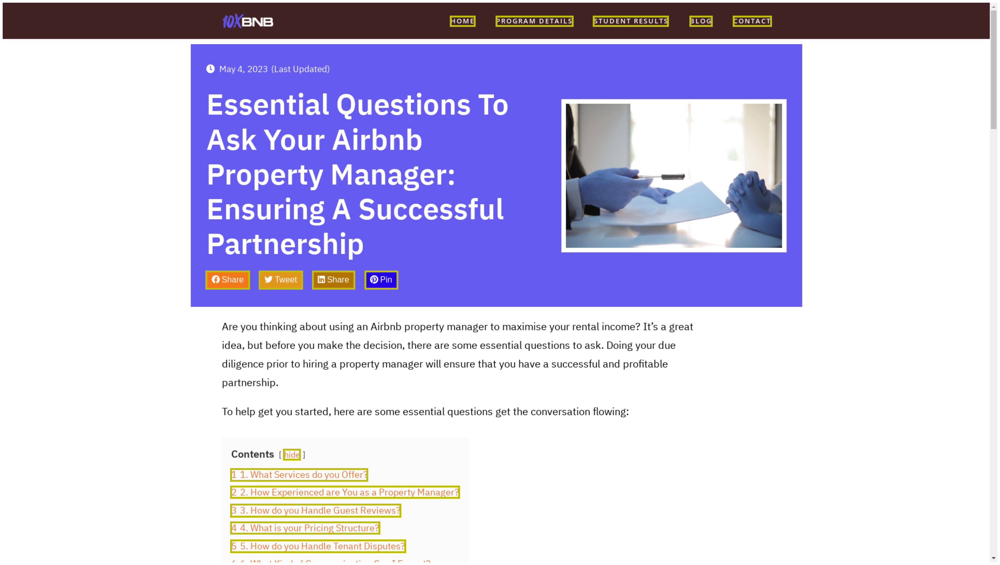

Elements:  28


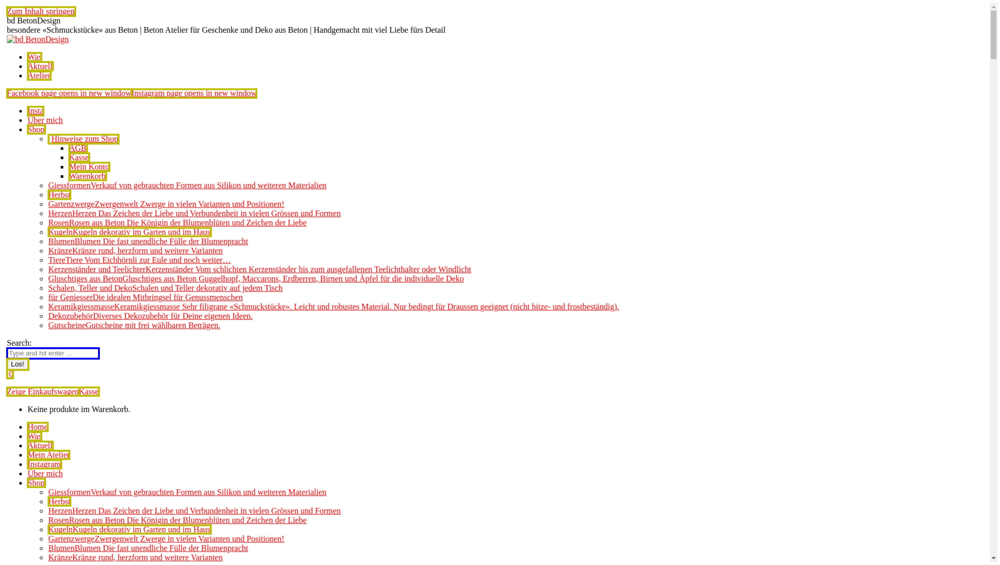

In [ ]:
current_items = subsetScheme[0:20]

for item in current_items:
  show_image_rect(item)